# Final Report for Advanced Math for Deep Learning

#### Team Members

- **Andre Graham** - 101555540  
- **Majed Qarmout** - 101565483  
- **Younes Bensassi-Nour** - 101542854  
- **Yonatan Abebe** - 101532284  
- **Adnan Shaikh** - 101549676


## 1. Motivation and Dataset Details

### 1.1 Motivation Behind our Project

The world faces a growing waste crisis, with **2.01 billion tonnes of solid waste produced annually**, according to the [World Bank (2018)](https://datatopics.worldbank.org/what-a-waste/). Alarmingly, **8 million tonnes of plastic leak into our oceans every year**, severely affecting marine ecosystems and human health ([World Economic Forum, 2016](https://www.ellenmacarthurfoundation.org/publications/the-new-plastics-economy-rethinking-the-future-of-plastics)). This litter not only pollutes land and water but also endangers wildlife, disrupts ecosystems, and exacerbates the global environmental crisis.  

Traditional waste management practices face significant challenges in addressing this problem. **Inefficient monitoring systems** often fail to promptly detect dispersed litter, and **manual sorting processes** are time-consuming, labor-intensive, and prone to human error. These limitations hinder effective cleanup efforts and reduce recycling efficiency, allowing waste to continue accumulating in the environment.  

Real-time trash detection offers a transformative solution to these challenges. By leveraging automated detection systems, it becomes possible to identify waste types quickly and accurately across diverse environments. This technology empowers **enhanced cleanup efforts**, allowing for timely interventions to remove harmful litter. Additionally, it streamlines recycling processes, increasing efficiency and reducing contamination rates.  

As we confront the pressing environmental impacts of litter, **real-time trash detection systems** emerge as a crucial tool in fostering sustainable waste management practices. By addressing inefficiencies in monitoring, cleanup, and recycling, these solutions hold the potential to mitigate pollution, protect ecosystems, and contribute to a healthier planet.

### 1.2 Dataset Reference

Proença, Pedro F., and Simões, Pedro.  
**TACO: Trash Annotations in Context for Litter Detection**.  
*arXiv preprint arXiv:2003.06975*, 2020.  
[Link to paper](https://arxiv.org/abs/2003.06975) \
[Link to dataset](https://github.com/pedropro/TACO)


### 1.3 Data Analysis

This section contains the code to load the dataset, examples of images with bounding boxes within the dataset, detailed descriptions of the categories of the objects within the datset, distributions of number of objects in the dataset and the number of images in the dataset with at least one of an object, and pie charts the further illustrate these distrbutions. 

In [ ]:
!git clone https://github.com/pedropro/TACO.git

Cloning into 'TACO'...
remote: Enumerating objects: 740, done.
remote: Counting objects: 100% (435/435), done.
remote: Compressing objects: 100% (55/55), done.
remote: Total 740 (delta 416), reused 380 (delta 380), pack-reused 305 (from 1)
Receiving objects: 100% (740/740), 97.48 MiB | 28.27 MiB/s, done.
Resolving deltas: 100% (499/499), done.


In [ ]:
%cd TACO
! python download.py
%cd ..

In [ ]:
import os

# Check the number of batch folders downloaded
data_path = 'TACO/data/'
batches = [folder for folder in os.listdir(data_path) if folder.startswith('batch_')]
print(f"Total number of batches: {len(batches)}")

Total number of batches: 15


In [ ]:
import json
import os

# Path to the annotations file
annotations_path = 'TACO/data/annotations.json'

# Check if the annotations file exists
if os.path.exists(annotations_path):
    with open(annotations_path, 'r') as f:
        data = json.load(f)

    # Get the number of images, categories, and annotations
    num_images = len(data['images'])  # List of images
    num_categories = len(data['categories'])  # List of categories
    num_annotations = len(data['annotations'])  # List of annotations

    print(f"Number of images: {num_images}")
    print(f"Number of categories: {num_categories}")
    print(f"Number of annotations: {num_annotations}")
else:
    print(f"Annotations file not found at: {annotations_path}")


Number of images: 1500
Number of categories: 60
Number of annotations: 4784


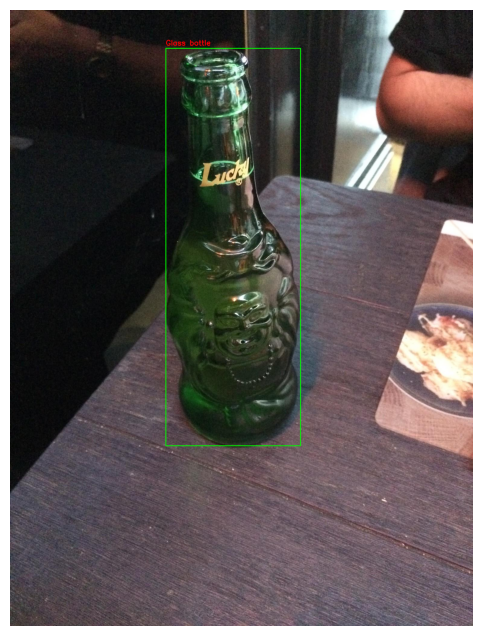

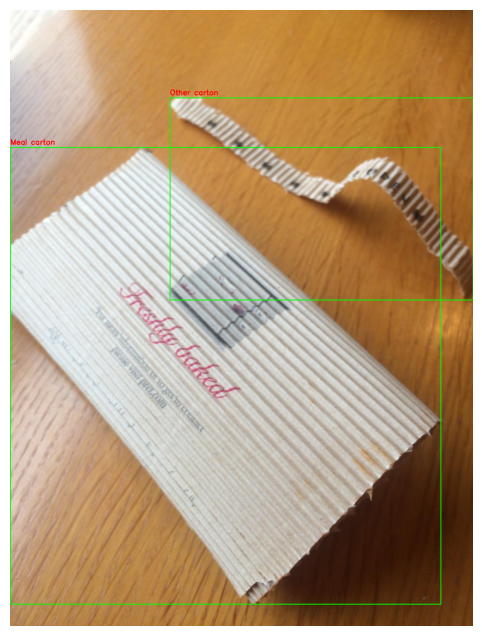

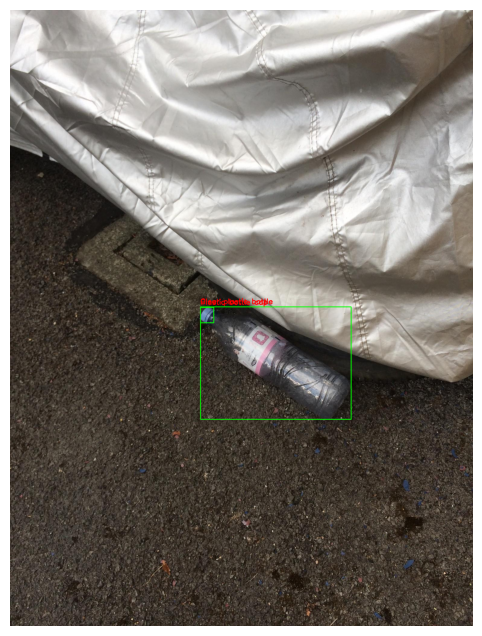

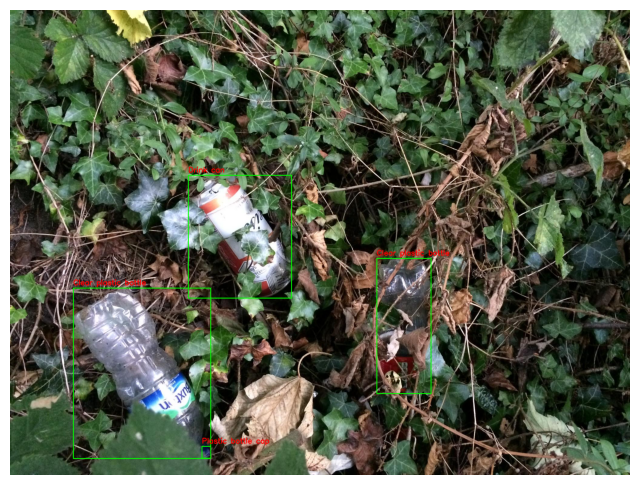

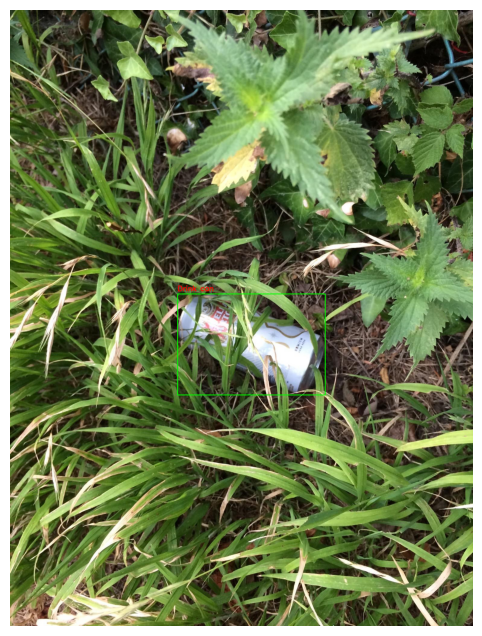

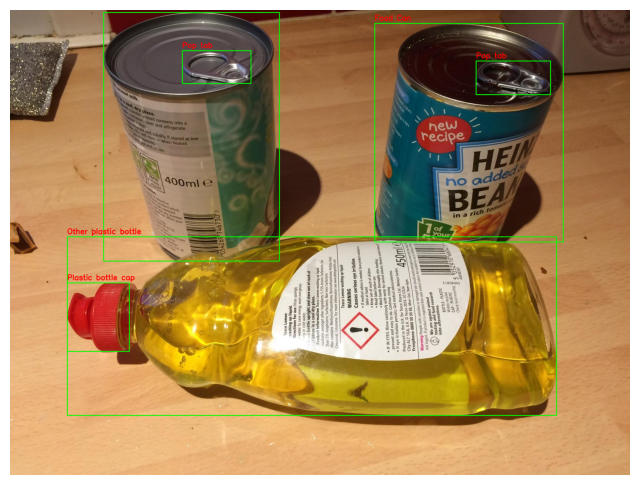

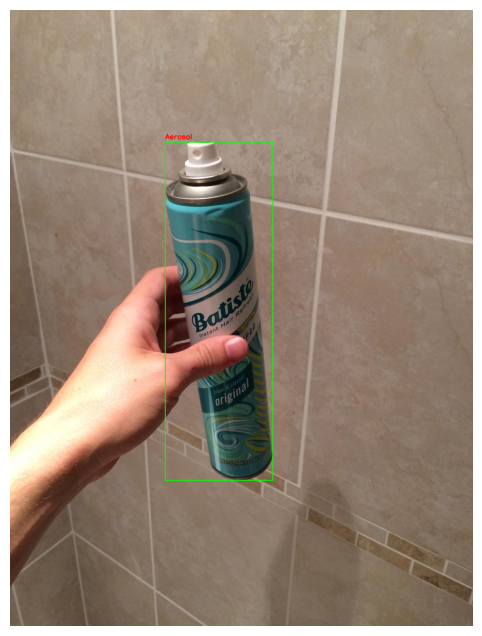

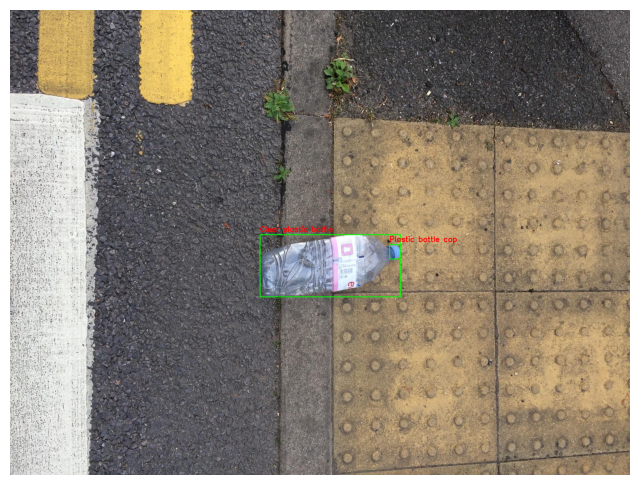

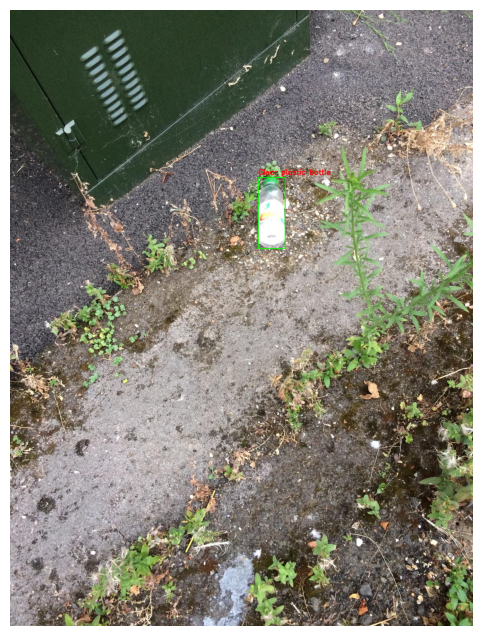

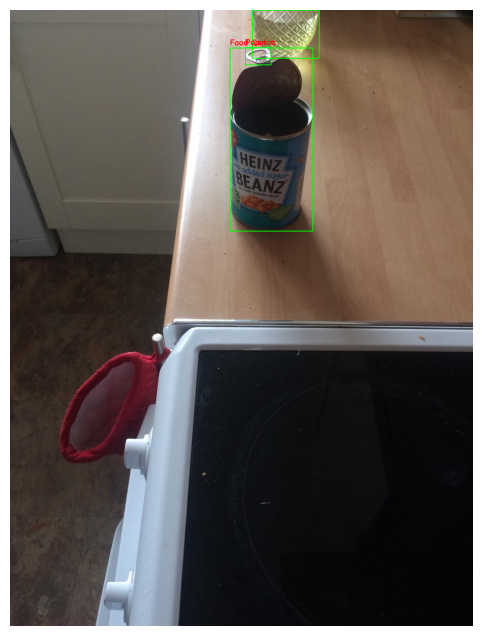

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Load the annotations file
with open(annotations_path) as f:
    annotations = json.load(f)
    
# Create dictionaries for images and annotations
images_dict = {img['id']: img for img in annotations['images']}
annotations_dict = {ann['image_id']: [] for ann in annotations['annotations']}
for ann in annotations['annotations']:
    annotations_dict[ann['image_id']].append(ann)

# Extract categories and annotations from the JSON data
categories = {cat['id']: cat['name'] for cat in data['categories']}
annotations = data['annotations']
images = {img['id']: img for img in data['images']}

def show_image_with_boxes(image_id):
    # Find the corresponding image info
    image_info = images.get(image_id)
    if not image_info:
        print(f"Image ID {image_id} not found in the dataset.")
        return

    # Construct the correct image path
    image_path = os.path.join(data_path, image_info['file_name'])

    # Check if the image exists
    if not os.path.exists(image_path):
        print(f"Could not find image at: {image_path}")
        return

    # Read the image using OpenCV
    image = cv2.imread(image_path)
    if image is None:
        print(f"Could not load image: {image_path}")
        return

    # Convert the image from BGR (OpenCV format) to RGB (for display in matplotlib)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Filter annotations for this image
    image_annotations = [ann for ann in annotations if ann['image_id'] == image_info['id']]

    # Draw bounding boxes and category labels on the image
    for ann in image_annotations:
        # Get bbox coordinates (x, y, width, height)
        x, y, width, height = map(int, ann['bbox'])  # Convert to integers
        category_id = ann['category_id']
        category_name = categories[category_id]

        # Draw the bounding box (green color, thickness=2)
        cv2.rectangle(image, (x, y), (x + width, y + height), (0, 255, 0), 2)

        # Add the category label in red above the bounding box
        label = f"{category_name}"
        cv2.putText(image, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 0), 2)

    # Display the image with bounding boxes and category labels using matplotlib
    plt.figure(figsize=(8, 8))
    plt.imshow(image)
    plt.axis('off')  # Hide axes for better visualization
    plt.show()

# Show the first 10 images with bounding boxes and category labels
for i in range(10):
    show_image_with_boxes(i)

In [ ]:
# Extract categories from the annotations data
categories = data.get('categories', [])

# Create a dictionary to store supercategories and their corresponding categories
supercategory_dict = {}

# Iterate over categories to group them by supercategory
for category in categories:
    supercategory = category.get('supercategory', 'Uncategorized')  # Default to 'Uncategorized' if no supercategory
    category_name = category.get('name', 'Unknown Category')

    # Add the category under the corresponding supercategory
    if supercategory not in supercategory_dict:
        supercategory_dict[supercategory] = []
    supercategory_dict[supercategory].append(category_name)

# Now print each supercategory and its categories
for supercategory, category_list in supercategory_dict.items():
    print(f"Supercategory: {supercategory}")
    for category in category_list:
        print(f" - {category}")
    print()  # Add an empty line for readability


Supercategory: Aluminium foil
 - Aluminium foil

Supercategory: Battery
 - Battery

Supercategory: Blister pack
 - Aluminium blister pack
 - Carded blister pack

Supercategory: Bottle
 - Other plastic bottle
 - Clear plastic bottle
 - Glass bottle

Supercategory: Bottle cap
 - Plastic bottle cap
 - Metal bottle cap

Supercategory: Broken glass
 - Broken glass

Supercategory: Can
 - Food Can
 - Aerosol
 - Drink can

Supercategory: Carton
 - Toilet tube
 - Other carton
 - Egg carton
 - Drink carton
 - Corrugated carton
 - Meal carton
 - Pizza box

Supercategory: Cup
 - Paper cup
 - Disposable plastic cup
 - Foam cup
 - Glass cup
 - Other plastic cup

Supercategory: Food waste
 - Food waste

Supercategory: Glass jar
 - Glass jar

Supercategory: Lid
 - Plastic lid
 - Metal lid

Supercategory: Other plastic
 - Other plastic

Supercategory: Paper
 - Magazine paper
 - Tissues
 - Wrapping paper
 - Normal paper

Supercategory: Paper bag
 - Paper bag
 - Plastified paper bag

Supercategory: Plast

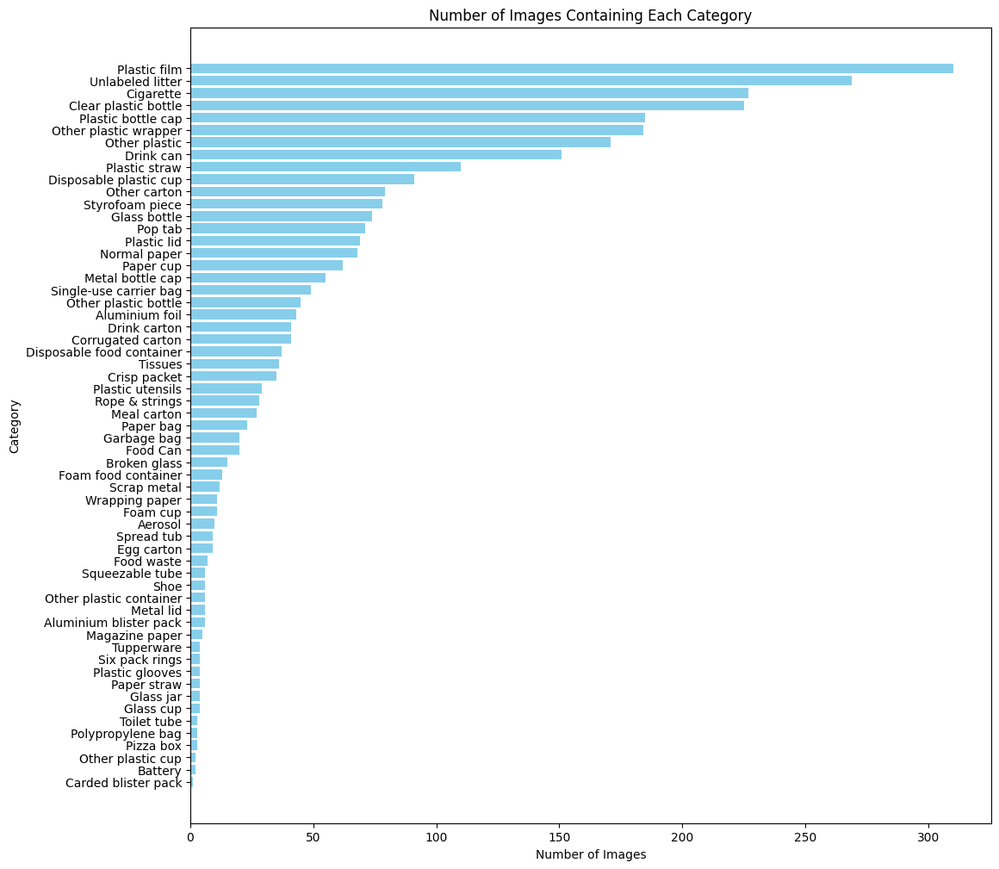

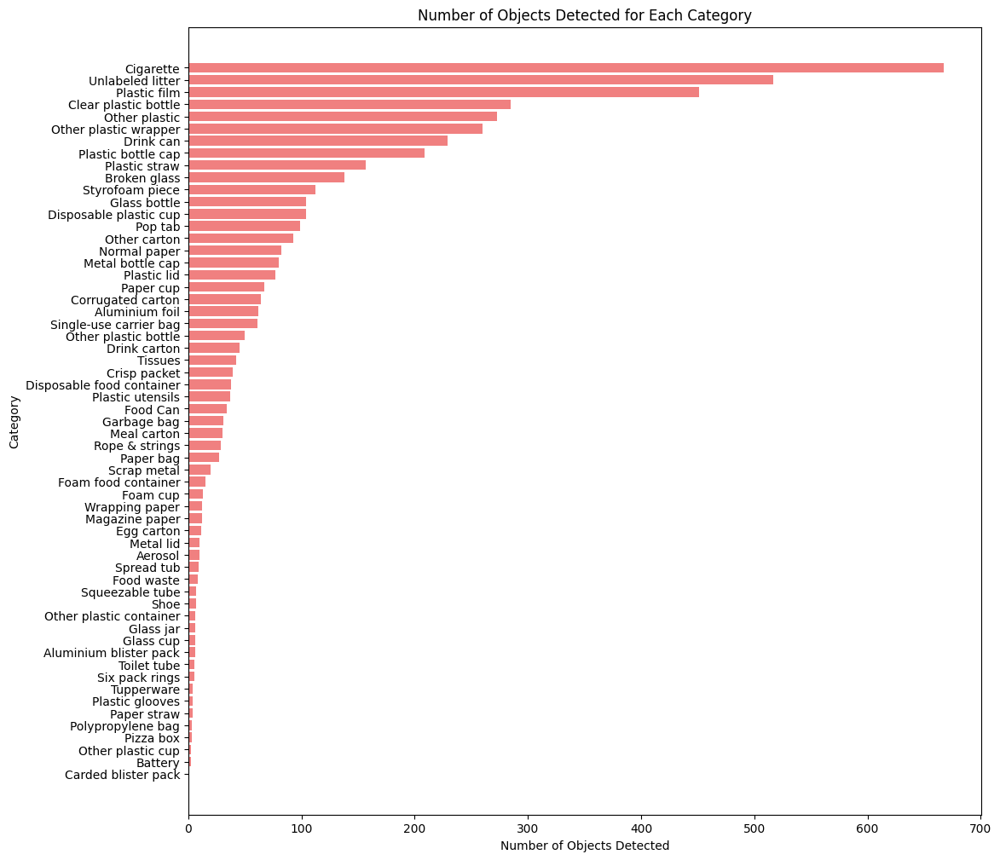

In [ ]:
from collections import defaultdict

# Extract the annotations and categories
annotations = data.get('annotations', [])
categories = data.get('categories', [])

# Create a mapping for category ids to names
category_id_to_name = {category['id']: category['name'] for category in categories}

# Create dictionaries to count images per category and objects per category
image_count_per_category = defaultdict(set)  # Uses a set to avoid counting the same image multiple times
object_count_per_category = defaultdict(int)

# Initialize total counts for calculating mean objects per image
total_objects = 0
unique_images = set()

# Iterate through annotations
for annotation in annotations:
    image_id = annotation['image_id']
    category_id = annotation['category_id']

    # Update the image count for the category (one image may contain multiple categories)
    image_count_per_category[category_id].add(image_id)

    # Update the object count for the category
    object_count_per_category[category_id] += 1

    # Update total objects and images
    total_objects += 1

    # Add image_id to the set of unique images
    unique_images.add(image_id)

# Convert image counts from sets to actual counts
image_count_per_category = {cat_id: len(images) for cat_id, images in image_count_per_category.items()}

# Convert category ids to category names for easier plotting
category_names = [category_id_to_name[cat_id] for cat_id in image_count_per_category.keys()]
image_counts = list(image_count_per_category.values())

# The total number of unique images
total_images = len(unique_images)

# Sort categories by number of images (descending order)
sorted_image_counts, sorted_category_names = zip(*sorted(zip(image_counts, category_names), reverse=False))

# Plot the histogram of number of images containing each category (sorted)
plt.figure(figsize=(12, 12))
plt.barh(sorted_category_names, sorted_image_counts, color='skyblue')
plt.xlabel('Number of Images')
plt.ylabel('Category')
plt.title('Number of Images Containing Each Category')
plt.show()

# Sort categories by number of objects (descending order)
object_counts = [object_count_per_category[cat_id] for cat_id in image_count_per_category.keys()]
sorted_object_counts, sorted_category_names_objects = zip(*sorted(zip(object_counts, category_names), reverse=False))

# Plot the histogram of number of objects detected for each category (sorted)
plt.figure(figsize=(12, 12))
plt.barh(sorted_category_names_objects, sorted_object_counts, color='lightcoral')
plt.xlabel('Number of Objects Detected')
plt.ylabel('Category')
plt.title('Number of Objects Detected for Each Category')
plt.show()


In [ ]:
# Calculate mean number of objects per image
mean_objects_per_image = round(total_objects / total_images, 2) if total_images != 0 else 0
print(f'Mean number of objects per image: {mean_objects_per_image}')

Mean number of objects per image: 3.19


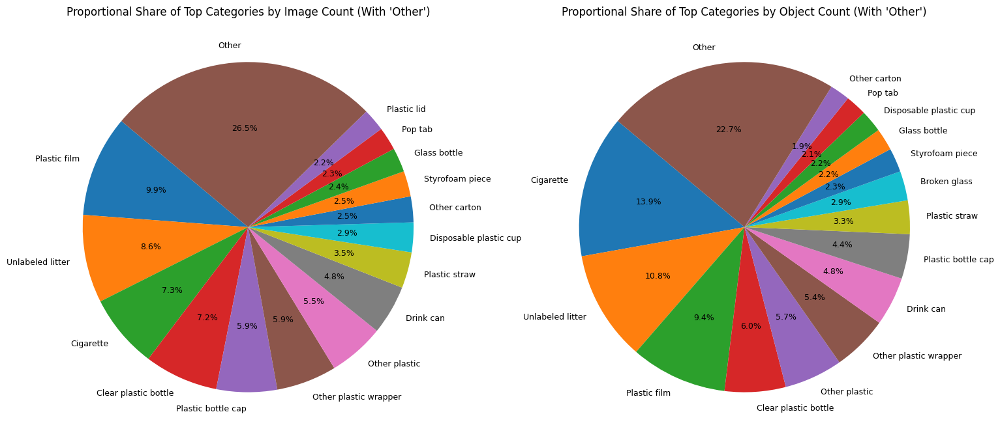

In [ ]:
# Assuming `object_count_per_category`, `image_count_per_category`, and `category_id_to_name` are defined as before

# Set the number of top categories to display
top_n = 15

# Sort and select the top categories for objects
sorted_object_counts = sorted(object_count_per_category.items(), key=lambda x: x[1], reverse=True)
top_object_categories = sorted_object_counts[:top_n]
other_object_categories = sorted_object_counts[top_n:]

# Sort and select the top categories for images
sorted_image_counts = sorted(image_count_per_category.items(), key=lambda x: x[1], reverse=True)
top_image_categories = sorted_image_counts[:top_n]
other_image_categories = sorted_image_counts[top_n:]

# Prepare data for top categories and 'Other' aggregation for images
top_image_category_names = [category_id_to_name[cat_id] for cat_id, _ in top_image_categories] + ["Other"]
top_image_category_counts = [count for _, count in top_image_categories]
top_image_category_counts.append(sum(count for _, count in other_image_categories))

# Prepare data for top categories and 'Other' aggregation for objects
top_object_category_names = [category_id_to_name[cat_id] for cat_id, _ in top_object_categories] + ["Other"]
top_object_category_counts = [count for _, count in top_object_categories]
top_object_category_counts.append(sum(count for _, count in other_object_categories))

# Calculate proportional shares
total_images = sum(top_image_category_counts)
proportional_shares_images = [(count / total_images) * 100 for count in top_image_category_counts]

total_objects = sum(top_object_category_counts)
proportional_shares_objects = [(count / total_objects) * 100 for count in top_object_category_counts]

# Plotting side-by-side pie charts with images on the left and objects on the right
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 10))

# Pie chart for image counts
ax1.pie(proportional_shares_images, labels=top_image_category_names, autopct='%1.1f%%', startangle=140, textprops={'fontsize': 9})
ax1.set_title("Proportional Share of Top Categories by Image Count (With 'Other')")

# Pie chart for object counts
ax2.pie(proportional_shares_objects, labels=top_object_category_names, autopct='%1.1f%%', startangle=140, textprops={'fontsize': 9})
ax2.set_title("Proportional Share of Top Categories by Object Count (With 'Other')")

plt.show()


## 2. Preprocessing Steps

Here we will include sections such as converting to YOLO format, the data training pipelines for both YOLO and CNN, we can have both the from scratch code and the YOLO code in different sections

### 2.1 Data Preprocessing for Transfer Learning with YOLO

For the sake of this assignment, we discovered very quickly while using this dataset that in order to achieve reasonable results, we must reduce the total number of categories in our dataset. This is motivated by the fact that the vast majority of the categories in the dataset are underrepresented. We began filtering out data by choosing only the categories that had at least 200 instances of objects within the dataset. This resulted in us working with 7 categories: Plastic film, Unlabeled litter, Cigarette, Clear plastic bottle, Plastic bottle cap, Other plastic wrapper, Other plastic, and Drink can. We quickly found out that Other plastic wrapper, Other plastic, and Unlabeled litter would not work within our model. This will be shown through comparing the results of YOLO trial #1 and trial #2 in sections 3 and sections 4. 

Below you can see the data training pipline for our YOLO model.

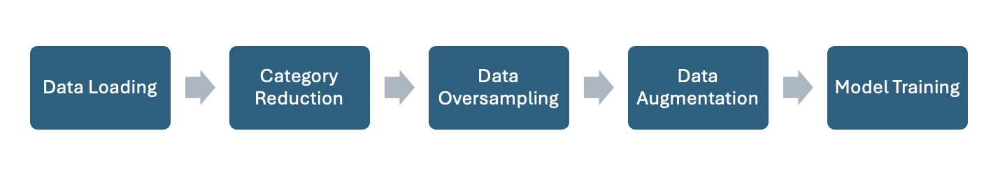

The remaining part of this section will show how we split the data into YOLO format, how we removed unwanted categories, and how we oversampled our data. Further data preprocessing such as normalization and data augmentation are completed during training the model. For brevitys sake, this section only includes how we preprocess the data for our final model. The only trials that have any different steps are trial #1, trial #3, and trial #4. To see the code that pre-processes that data for those trials, please visit our [GitHub](https://github.com/mqarmout/TACO_object__detection) page for this project and see their respective python notebooks. This can be found in the YOLO directory.

The following code converts the data into YOLO format.

In [ ]:
import json
import os
from pathlib import Path
import shutil

# Paths to your TACO dataset
coco_json_path = 'TACO/data/annotations.json'  # Path to TACO's annotations file
images_dir = 'TACO/data'                       # Path to TACO's main image directory with batch subfolders
output_dir = 'yolo_top_categories'             # Base directory for YOLO format

# Ensure output directories for images and labels
Path(output_dir, 'images').mkdir(parents=True, exist_ok=True)
Path(output_dir, 'labels').mkdir(parents=True, exist_ok=True)

# Load TACO annotations
with open(coco_json_path, 'r') as f:
    data = json.load(f)

# Get category mappings
categories = {category['id']: category['name'] for category in data['categories']}

# Counter for unique filenames
file_counter = 1

# Process each image and corresponding annotations
for img in data['images']:
    img_id = img['id']
    img_file_name = img['file_name']  # This should be in the format 'batch_x/filename.jpg'
    img_width, img_height = img['width'], img['height']

    # Derive the image path within one of the 15 batch folders
    img_path = os.path.join(images_dir, img_file_name)

    # Create a unique integer-based name for each image and label
    unique_name = str(file_counter)
    img_extension = os.path.splitext(img_file_name)[1]  # Preserve the original extension (e.g., .jpg, .png)

    # Copy image to the images directory with the new unique name
    output_image_path = os.path.join(output_dir, 'images', unique_name + img_extension)
    if os.path.exists(img_path):
        shutil.copy(img_path, output_image_path)

        # Create a corresponding label file with the same unique integer name
        label_file_path = os.path.join(output_dir, 'labels', unique_name + '.txt')
        with open(label_file_path, 'w') as label_file:
            # Find all annotations for the current image
            for ann in data['annotations']:
                if ann['image_id'] == img_id:
                    category_id = ann['category_id']
                    # Ensure the category is in our mapping
                    if category_id in categories:
                        # YOLO format requires x_center, y_center, width, and height normalized
                        x, y, width, height = ann['bbox']
                        x_center = (x + width / 2) / img_width
                        y_center = (y + height / 2) / img_height
                        width /= img_width
                        height /= img_height

                        # Write the label file in YOLO format: <class_id> <x_center> <y_center> <width> <height>
                        label_file.write(f"{category_id} {x_center} {y_center} {width} {height}\n")

        # Increment the counter for the next file
        file_counter += 1

# Print the total number of images moved
print(f"Total number of images processed: {file_counter - 1}")

Total number of images processed: 1500


Next, we delete the unwanted categories from our labels. We also delete all images that do not contain any relavent objects along with their corresponding labels. For a more detailed description of exactly what the code is doing, please refer to the comments.

In [ ]:
import os

# Path to the base directory containing unified 'images' and 'labels' folders
base_dir = 'yolo_top_categories'  # Adjust if necessary
label_dir = os.path.join(base_dir, 'labels')
image_dir = os.path.join(base_dir, 'images')

# Initialize a counter for deleted files
total_deleted_files = 0

# Loop over each label file in the labels directory
for label_file in os.listdir(label_dir):
    label_file_path = os.path.join(label_dir, label_file)

    # Check if the label file is empty
    if os.path.getsize(label_file_path) == 0:
        # Construct possible image file paths
        base_image_name = os.path.splitext(label_file)[0]
        image_file_path_jpg = os.path.join(image_dir, base_image_name + '.jpg')
        image_file_path_jpg_upper = os.path.join(image_dir, base_image_name + '.JPG')

        # Delete the label file
        os.remove(label_file_path)
        total_deleted_files += 1

        # Delete the associated image file if it exists
        if os.path.exists(image_file_path_jpg):
            os.remove(image_file_path_jpg)
            total_deleted_files += 1
        elif os.path.exists(image_file_path_jpg_upper):
            os.remove(image_file_path_jpg_upper)
            total_deleted_files += 1

# Print the total number of files deleted
print(f"Total number of files deleted (label and image): {total_deleted_files}")

Total number of files deleted (label and image): 1374


Next, we split the dataset into training, valdiation, and testing directories, staying in line with YOLO formatting.

In [ ]:
import shutil
import random

random.seed(42)

# Set the split ratios
train_ratio = 0.7
val_ratio = 0.2
test_ratio = 0.1

# Ensure output directories for each split
for split in ['train', 'val', 'test']:
    os.makedirs(os.path.join(base_dir, split, 'images'), exist_ok=True)
    os.makedirs(os.path.join(base_dir, split, 'labels'), exist_ok=True)

# Get a list of all images and shuffle them
all_images = [f for f in os.listdir(image_dir) if os.path.isfile(os.path.join(image_dir, f))]
random.shuffle(all_images)

# Calculate split sizes
num_train = int(len(all_images) * train_ratio)
num_val = int(len(all_images) * val_ratio)

# Assign images to each split
train_images = all_images[:num_train]
val_images = all_images[num_train:num_train + num_val]
test_images = all_images[num_train + num_val:]

# Move files to their respective split directories
for split, images in zip(['train', 'val', 'test'], [train_images, val_images, test_images]):
    for image_file in images:
        # Move image file
        src_image_path = os.path.join(image_dir, image_file)
        dst_image_path = os.path.join(base_dir, split, 'images', image_file)
        shutil.move(src_image_path, dst_image_path)

        # Move corresponding label file
        label_file = os.path.splitext(image_file)[0] + '.txt'
        src_label_path = os.path.join(label_dir, label_file)
        dst_label_path = os.path.join(base_dir, split, 'labels', label_file)
        if os.path.exists(src_label_path):  # Ensure corresponding label file exists
            shutil.move(src_label_path, dst_label_path)

# Print the number of images in each split
print(f"Number of images in train: {len(train_images)}")
print(f"Number of images in val: {len(val_images)}")
print(f"Number of images in test: {len(test_images)}")

Number of images in train: 569
Number of images in val: 162
Number of images in test: 82


We then delete the directories we orginally created for the images and labels to ensure we do not have unnecessary directories in our project files.

In [ ]:
# Paths to the original images and labels directories
image_dir = os.path.join(base_dir, 'images')
label_dir = os.path.join(base_dir, 'labels')

# Delete the original images and labels directories
if os.path.exists(image_dir):
    shutil.rmtree(image_dir)

if os.path.exists(label_dir):
    shutil.rmtree(label_dir)

print("Original images and labels directories have been deleted.")

Original images and labels directories have been deleted.


Due to there note being an even distribution of objects in the dataset, we perform oversampling to balance our training dataset.

In [ ]:
import os
from collections import Counter

def count_class_instances(label_dir):
    class_counts = Counter()
    for label_file in os.listdir(label_dir):
        label_file_path = os.path.join(label_dir, label_file)
        with open(label_file_path, 'r') as f:
            lines = f.readlines()
            for line in lines:
                class_id = int(line.strip().split()[0])
                class_counts[class_id] += 1
    return class_counts

# Paths to training labels
train_label_dir = os.path.join(base_dir, 'train', 'labels')

# Get class counts
class_counts = count_class_instances(train_label_dir)

print("Class distribution in the training set:")
for class_id, count in class_counts.items():
    print(f"Class {class_id}: {count} instances")


Class distribution in the training set:
Class 2: 195 instances
Class 0: 324 instances
Class 1: 476 instances
Class 4: 173 instances
Class 3: 148 instances


In [ ]:
# Determine the threshold for underrepresentation (e.g., 50% of the max count)
max_count = max(class_counts.values())
threshold = 0.8 * max_count

# Identify underrepresented classes
underrepresented_classes = [class_id for class_id, count in class_counts.items() if count < threshold]

print("\nUnderrepresented classes:")
for class_id in underrepresented_classes:
    print(f"Class {class_id}: {class_counts[class_id]} instances")


Underrepresented classes:
Class 2: 195 instances
Class 0: 324 instances
Class 4: 173 instances
Class 3: 148 instances


In [ ]:
# Calculate the number of instances needed for each underrepresented class

target_count = int(0.90* max_count)  # 80% of the max count

instances_needed = {}
for class_id, count in class_counts.items():
    if count < target_count:
        instances_needed[class_id] = int(target_count - count)

print("\nInstances needed for balance:")
for class_id, count_needed in instances_needed.items():
    print(f"Class {class_id}: {count_needed} instances needed")


Instances needed for balance:
Class 2: 233 instances needed
Class 0: 104 instances needed
Class 4: 255 instances needed
Class 3: 280 instances needed


In [ ]:
# Initialize a mapping from class IDs to image filenames
images_to_duplicate = {class_id: [] for class_id in underrepresented_classes}

# Loop through label files to identify suitable images
for label_file in os.listdir(train_label_dir):
    label_file_path = os.path.join(train_label_dir, label_file)
    with open(label_file_path, 'r') as f:
        lines = f.readlines()
        image_classes = set()
        for line in lines:
            class_id = int(line.strip().split()[0])
            image_classes.add(class_id)
        # Check if the image contains only underrepresented classes
        if image_classes.issubset(underrepresented_classes):
            for class_id in image_classes:
                images_to_duplicate[class_id].append(label_file)

In [ ]:
import shutil
import numpy as np

# Directory paths
train_image_dir = os.path.join(base_dir, 'train', 'images')
train_label_dir = os.path.join(base_dir, 'train', 'labels')

# Counter for new filenames
duplication_counter = 0

# Oversample images for each underrepresented class
for class_id in underrepresented_classes:
    count_needed = instances_needed[class_id]
    available_labels = images_to_duplicate[class_id]
    if not available_labels:
        print(f"No images found containing only class {class_id}")
        continue

    total_images = len(available_labels)
    duplicates_per_image = int(np.ceil(count_needed / total_images))

    for label_filename in available_labels:
        if count_needed <= 0:
            break

        image_filename = os.path.splitext(label_filename)[0]
        image_extensions = ['.jpg', '.png', '.jpeg']  # Adjust based on your dataset

        # Find the correct image extension
        for ext in image_extensions:
            image_path = os.path.join(train_image_dir, image_filename + ext)
            if os.path.exists(image_path):
                break
        else:
            continue  # Skip if image file not found

        label_path = os.path.join(train_label_dir, label_filename)

        for _ in range(duplicates_per_image):
            if count_needed <= 0:
                break

            # Create new filenames for duplicated files
            new_image_filename = f"{image_filename}_dup_{duplication_counter}{ext}"
            new_label_filename = f"{image_filename}_dup_{duplication_counter}.txt"

            new_image_path = os.path.join(train_image_dir, new_image_filename)
            new_label_path = os.path.join(train_label_dir, new_label_filename)

            # Copy image and label files
            shutil.copy(image_path, new_image_path)
            shutil.copy(label_path, new_label_path)

            count_needed -= len(open(label_path).readlines())
            duplication_counter += 1

print(f"\nOversampling completed. Duplicated images {duplication_counter} times.")


Oversampling completed. Duplicated images 393 times.


Below, the results of our oversampling can be seen. Notice the difference in the distributions of the training set relative to the validation and test sets, indicating that oversampling was successful. 

In [ ]:
# Re-count class instances after oversampling
new_class_counts = count_class_instances(train_label_dir)

print("\nUpdated class distribution in the training set:")
for class_id in sorted(new_class_counts.keys()):
    print(f"Class {class_id}: {new_class_counts[class_id]} instances")


Updated class distribution in the training set:
Class 0: 483 instances
Class 1: 476 instances
Class 2: 442 instances
Class 3: 379 instances
Class 4: 413 instances


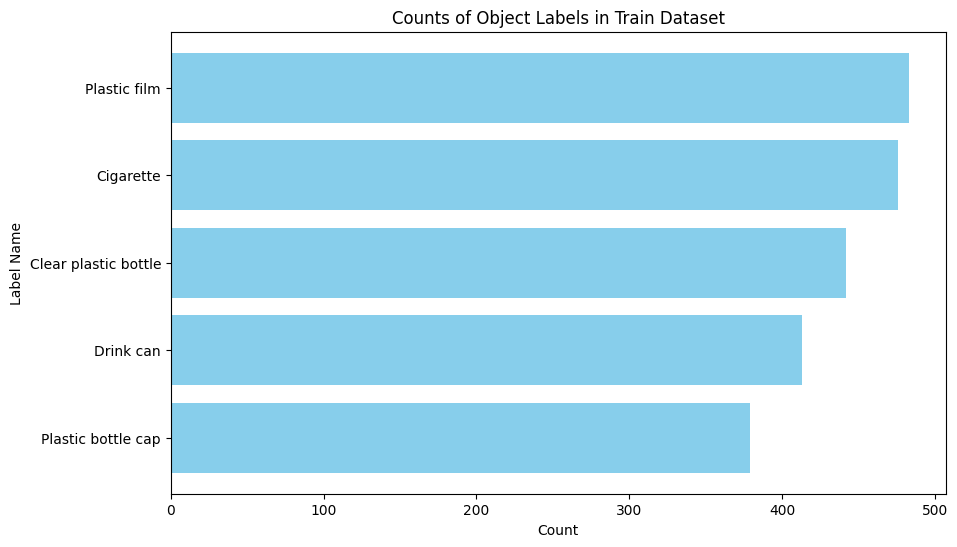

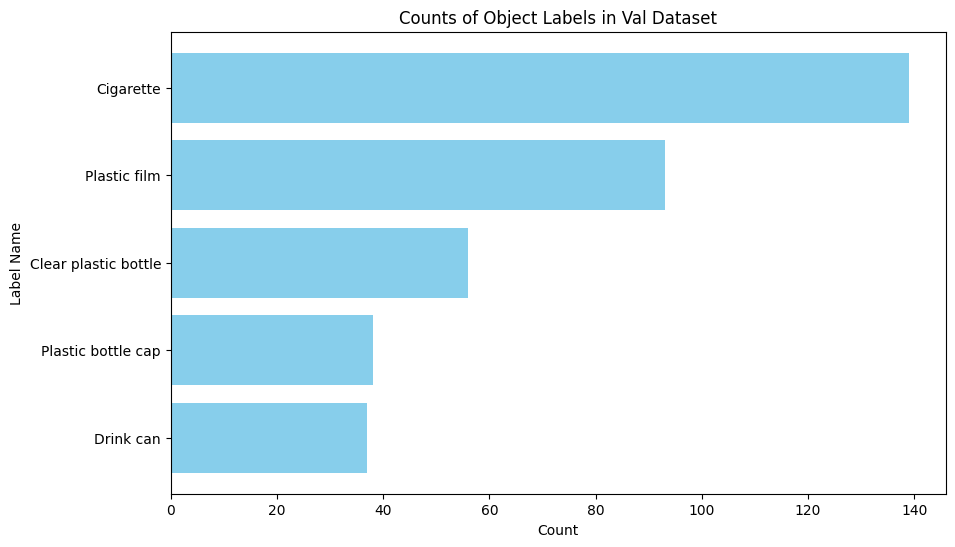

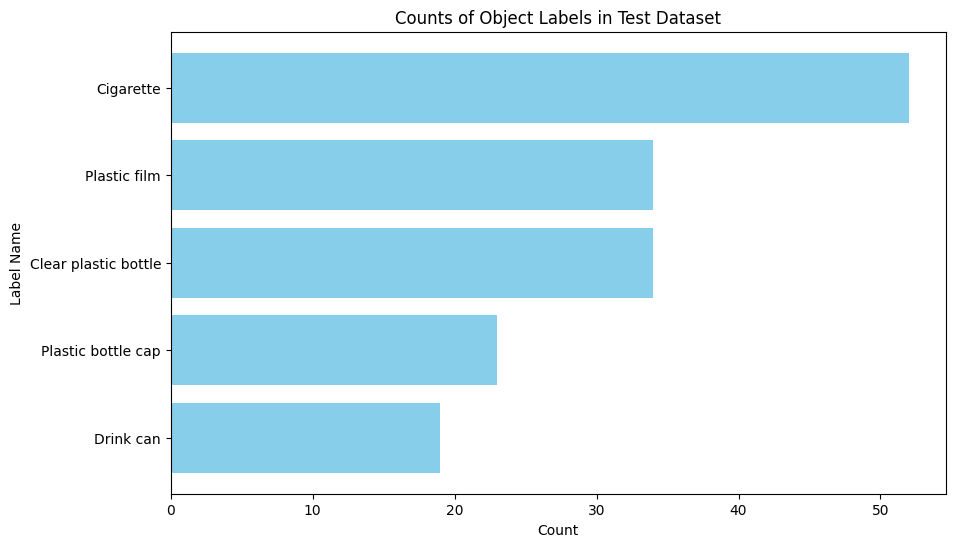

In [ ]:
import matplotlib.pyplot as plt

# Define a mapping from label IDs to names, excluding unwanted categories
label_names = {
    0: "Plastic film",
    1: "Cigarette",
    2: "Clear plastic bottle",
    3: "Plastic bottle cap",
    4: "Drink can"
}



# Function to plot label counts for a given split
def plot_label_counts(split, label_counts):
    # Convert label IDs to label names and sort by count
    labels, counts = zip(*sorted(
        [(label_names[label_id], count) for label_id, count in label_counts.items()],
        key=lambda x: x[1]
    ))

    # Plotting a horizontal bar chart for the split
    plt.figure(figsize=(10, 6))
    plt.barh(labels, counts, color='skyblue')
    plt.xlabel("Count")
    plt.ylabel("Label Name")
    plt.title(f"Counts of Object Labels in {split.capitalize()} Dataset")
    plt.show()

# Loop through each split and calculate label distributions
for split in ['train', 'val', 'test']:
    label_dir_split = os.path.join(base_dir, split, 'labels')

    # Initialize a counter for label counts for the current split
    label_counts = Counter()

    # Loop over each label file in the current label directory
    for label_file in os.listdir(label_dir_split):
        label_file_path = os.path.join(label_dir_split, label_file)

        # Read the label file
        with open(label_file_path, 'r') as file:
            lines = file.readlines()

            # Count each label in the file
            for line in lines:
                parts = line.strip().split()
                label_id = int(parts[0])  # The label ID is the first element
                label_counts[label_id] += 1

    # Plot label counts for the current split
    plot_label_counts(split, label_counts)


Finally, we create a YAML file which will be necessary for training our model. 

In [ ]:
import yaml

# Define the details for the YAML file, excluding unwanted categories
data_config = {
    'train': '/content/yolo_top_categories/train/images',
    'val': '/content/yolo_top_categories/val/images',
    'test': '/content/yolo_top_categories/test/images',
    'nc': 5,  # Updated number of classes
    'names': [
        "Plastic film",
        "Cigarette",
        "Clear plastic bottle",
        "Plastic bottle cap",
        "Drink can"
    ]
}

# Write to a YAML file
yaml_file_path = 'taco.yaml'  # Path where the YAML file will be saved
with open(yaml_file_path, 'w') as file:
    yaml.dump(data_config, file, default_flow_style=False)

print(f"YAML file created at: {yaml_file_path}")

YAML file created at: taco.yaml


### 2.2 Data Preprocessing for the Custom CNN Object Detection Model from Scratch

This section will include

- all data preprocessing code relavent to your model (make sure that it doesn't mess up the YOLO code, it just be completely seperate)
- the data training pipeline 

---

## 3. Base Model Training

### 3.1 Base Model Training for YOLO

The following is the summary of the base trial using YOLOv8l model

Trial Number: Trial 1
Date: 2024-11-12
Objective: Establish a baseline performance with a large YOLO model to detect small objects in complex environments.

---

Adjustments:
- Model Architecture: YOLOv8 large model (`yolov8l.pt`) selected to better handle small objects and complex backgrounds.
- Image Resolution: High resolution (1536x1536) was used to capture detail, crucial for detecting small objects within the dataset.
- Dataset Modification: Categories reduced to include only classes with a significant number of objects, increasing focus on relevant data and reducing noise.
- Hyperparameters:
  - Epochs: 100
  - Batch Size: 16
  - Patience: 15 (early stopping if no improvement)
  - Freeze Layers: First 10 layers frozen to leverage pretrained weights for low-level feature extraction
  - Augmentation: Enabled to help with model generalization on diverse backgrounds

---

Results:
Model Summary:
- Layers: 268
- Parameters: 43,612,776
- GFLOPs: 164.8

Performance Metrics:
- Overall:
  - Precision: 0.405
  - Recall: 0.363
  - mAP@50: 0.320
  - mAP@50-95: 0.235

Class-wise Metrics:
| Class                  | Instances | Precision | Recall | mAP@50 | mAP@50-95 |
|------------------------|-----------|-----------|--------|--------|------------|
| Plastic film           | 100       | 0.309     | 0.450  | 0.300  | 0.219      |
| Unlabeled litter       | 107       | 0.186     | 0.215  | 0.0841 | 0.0458     |
| Cigarette              | 112       | 0.626     | 0.411  | 0.443  | 0.252      |
| Clear plastic bottle   | 61        | 0.683     | 0.494  | 0.574  | 0.466      |
| Plastic bottle cap     | 39        | 0.385     | 0.513  | 0.458  | 0.352      |
| Other plastic wrapper  | 85        | 0.351     | 0.129  | 0.202  | 0.121      |
| Other plastic          | 59        | 0.392     | 0.153  | 0.150  | 0.132      |
| Drink can              | 35        | 0.306     | 0.543  | 0.345  | 0.289      |

Speed:
- Preprocessing: 0.7ms per image
- Inference: 100.4ms per image
- Postprocess: 0.9ms per image

---

Observations:
- The model architecture and high resolution have resulted in relatively strong performance on classes like Cigarette and Clear plastic bottle, likely due to the model’s ability to capture finer details at higher resolutions.
- Unlabeled litter, Other plastic wrapper, and Other plastic categories show low precision and recall, indicating difficulties in recognizing these classes in complex backgrounds.
- Average precision (mAP@50) across classes suggests that model adjustments are needed to improve detection, particularly in the challenging background settings.

Next Steps:
- Refine Classes: Consider removing low-performing categories (e.g., Unlabeled litter, Other plastic wrapper, Other plastic) to focus on classes with better detection potential.
- Augmentation Review: Investigate additional or targeted augmentation strategies that might better address the complex backgrounds in the dataset.
- Experiment with Hyperparameters: Consider reducing the batch size or adjusting learning rate to improve model convergence.

This baseline provides a foundation for further tuning and optimizations in subsequent trials.


This is the code that we used to run the model as well as the output. **This code will not run within this file**. For reproduceability, please load `Trial #1.ipynb` file on our projects [GitHub](https://github.com/mqarmout/TACO_object__detection) into Google Colab. If you then simply 'run all', you will be able to reproduce our results.

In [ ]:
!pip install ultralytics

In [ ]:
from ultralytics import YOLO

# Path to the YAML configuration file
data_yaml = 'taco.yaml'  # Update with the path to your taco.yaml file
model_type = 'yolov8l.pt'  # You can use other YOLOv8 models like yolov8s.pt, yolov8m.pt, etc.

# Load a pre-trained YOLOv8 model
model = YOLO(model_type)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 83.7M/83.7M [00:02<00:00, 40.3MB/s]


In [ ]:
# Train the model
model.train(
    data=data_yaml,
    epochs=100,
    imgsz=1536,
    batch=16,
    patience=15,
    freeze=10,
    augment=True
)

Ultralytics 8.3.29 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=taco.yaml, epochs=100, time=None, patience=15, batch=16, imgsz=1536, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=10, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=

100%|██████████| 755k/755k [00:00<00:00, 129MB/s]


Overriding model.yaml nc=80 with nc=8

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  3    279808  ultralytics.nn.modules.block.C2f             [128, 128, 3, True]           
  3                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  4                  -1  6   2101248  ultralytics.nn.modules.block.C2f             [256, 256, 6, True]           
  5                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256, 512, 3, 2]              
  6                  -1  6   8396800  ultralytics.nn.modules.block.C2f             [512, 512, 6, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 338MB/s]


AMP: checks passed ✅


train: Scanning /content/yolo_top_categories/train/labels... 760 images, 0 backgrounds, 0 corrupt: 100%|██████████| 760/760 [00:00<00:00, 1074.54it/s]

train: New cache created: /content/yolo_top_categories/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/yolo_top_categories/val/labels... 217 images, 0 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:00<00:00, 870.12it/s]

val: New cache created: /content/yolo_top_categories/val/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000833, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 1536 train, 1536 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      20.1G      1.109      5.218      1.255         43       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.84s/it]

                   all        217        598      0.142      0.229        0.1     0.0709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      19.5G      1.215      3.849      1.322         48       1536: 100%|██████████| 48/48 [01:21<00:00,  1.71s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.61s/it]

                   all        217        598      0.185      0.185      0.101     0.0654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      19.5G      1.256      2.977      1.353         23       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:19<00:00,  2.85s/it]

                   all        217        598       0.12      0.192     0.0781     0.0465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      19.5G      1.272      2.675      1.321         27       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.74s/it]

                   all        217        598      0.244      0.292      0.168     0.0954



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      19.9G      1.261      2.353      1.372         28       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.63s/it]

                   all        217        598        0.3      0.234      0.187      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      19.5G      1.202      2.151      1.297         36       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.62s/it]

                   all        217        598       0.34       0.26      0.216      0.147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      19.2G      1.157      2.056      1.279         48       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.61s/it]

                   all        217        598      0.285      0.293      0.218      0.145



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      19.7G      1.096      1.972      1.241         46       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.58s/it]

                   all        217        598      0.295      0.297      0.221       0.14



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      20.2G      1.086      1.784      1.225         17       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.58s/it]

                   all        217        598      0.301      0.328      0.245      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      19.8G      1.066      1.719       1.23         19       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.57s/it]

                   all        217        598      0.309      0.284      0.232      0.154



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      19.9G      1.065      1.669      1.203         45       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598        0.3      0.335      0.261      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      19.5G      1.013      1.526      1.167         34       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598      0.341      0.284      0.249      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      18.9G     0.9882      1.428      1.159         23       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598      0.361      0.277      0.236      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      18.5G     0.9375      1.381       1.14         58       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598      0.315      0.312      0.239      0.171



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      18.5G     0.9471      1.317      1.138         25       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.57s/it]

                   all        217        598      0.281      0.348      0.247      0.176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      18.9G     0.9207      1.253      1.109         41       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.57s/it]

                   all        217        598      0.337      0.291      0.246      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      18.9G       0.92      1.262      1.131         19       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598      0.407      0.327      0.301      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      19.7G     0.8918       1.16      1.081         42       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598      0.308      0.339      0.252      0.176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      19.9G     0.9158      1.171      1.103         39       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.56s/it]

                   all        217        598       0.35      0.328      0.269      0.192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      20.7G     0.8913      1.113      1.089         78       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598      0.319      0.324      0.262      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      19.6G     0.8728     0.9909      1.066         26       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.57s/it]

                   all        217        598      0.368      0.344      0.286      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      19.9G     0.8351     0.9542      1.048         14       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.57s/it]

                   all        217        598      0.325       0.34      0.266      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      18.9G     0.8269     0.9688      1.066         26       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.57s/it]

                   all        217        598       0.31      0.354      0.271      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      19.6G     0.8226     0.9579      1.076         22       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598       0.32      0.346      0.255      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      19.7G     0.8244     0.9479      1.065         17       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.57s/it]

                   all        217        598       0.34      0.333      0.268      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      20.6G      0.809     0.9046      1.039         38       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598      0.347      0.348      0.273      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      20.8G     0.7893     0.8914      1.039         39       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598      0.344      0.342      0.272        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      19.7G     0.7893     0.8652      1.033         24       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.57s/it]

                   all        217        598      0.324      0.375      0.261      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      18.8G     0.7732     0.8174      1.026         63       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598      0.349      0.355      0.279      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      20.5G      0.752      0.816      1.018         25       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.57s/it]

                   all        217        598      0.411      0.311      0.292      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      20.9G     0.7671     0.8195      1.027         24       1536: 100%|██████████| 48/48 [01:21<00:00,  1.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.57s/it]

                   all        217        598      0.342       0.32      0.277      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      20.1G     0.7588     0.7664      1.009         29       1536: 100%|██████████| 48/48 [01:21<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:10<00:00,  1.57s/it]

                   all        217        598      0.307      0.366      0.273      0.188
EarlyStopping: Training stopped early as no improvement observed in last 15 epochs. Best results observed at epoch 17, best model saved as best.pt.
To update EarlyStopping(patience=15) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



32 epochs completed in 0.839 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 87.8MB
Optimizer stripped from runs/detect/train/weights/best.pt, 87.8MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.29 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 268 layers, 43,612,776 parameters, 0 gradients, 164.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:23<00:00,  3.30s/it]


                   all        217        598      0.405      0.363       0.32      0.235
          Plastic film         64        100      0.309       0.45        0.3      0.219
      Unlabeled litter         55        107      0.186      0.215     0.0841     0.0458
             Cigarette         46        112      0.626      0.411      0.443      0.252
  Clear plastic bottle         51         61      0.683      0.494      0.574      0.466
    Plastic bottle cap         36         39      0.385      0.513      0.458      0.352
 Other plastic wrapper         47         85      0.351      0.129      0.202      0.121
         Other plastic         33         59      0.392      0.153       0.15      0.132
             Drink can         27         35      0.306      0.543      0.345      0.289
Speed: 0.7ms preprocess, 100.4ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ddcb009d0f0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,

### 3.2 Base Model Training for the Custom CNN Object Detection Model from Scratch

---

## 4. Hyperparameter Tuning

### 4.1 Hyperparameter Tuning for YOLO

In total we completed 10 different trials testing new hyperparameters for YOLO. Each trial was built off of the last, keeping things that worked and removing things that did not. For our first 6 trials, we used L4 GPUs since we did not need more than 22 GBs of GPU memory. However, for later trials, we used larger YOLO models, which required the use of A100 GPUs for training. 

The following is a list of parameters tuned throughout the testing period.

1. **Epochs**: 
   - Trials 1–4: 100  
   - Trials 5–10: 200  

2. **Batch Size**: 16 (consistent across all trials)

3. **Patience (Early Stopping)**: 
   - Trials 1–4: 15  
   - Trials 5–10: 30  

4. **Freeze Layers**: 
   - Trials 1–6: First 10 layers frozen  
   - Trial 7: Increased to 15 layers  
   - Trial 9: Reduced to 5 layers  

5. **Learning Rate**:  
   - Trial 1-5: Default
   - Trial 6: `1e-4`  
   - Trials 8–10: `1e-5`  

6. **Optimizer**:  
   - Default (early trials): AUTO
   - Trials 6–10: Adam  

7. **Weight Decay**: 
   - Introduced in Trial 6: `5e-4`  

8. **Warmup**: 
   - Introduced in Trial 6: 3 warmup epochs with momentum of 0.8  

9. **Image Size**: 1536 (consistent across all trials)

10. **Dropout**: 
    - Trial 9: Introduced with a value of `0.1`  

11. **Scheduler**: 
    - Introduced in Trial 6: Cosine Learning Rate Scheduler  

#### Augmentation Hyperparameters
1. **Enabled**: Trials 1–10 for generalization purposes.

2. **MixUp Augmentation**: 
   - Trial 6 onwards: Probability `0.2`  

3. **HSV Augmentations** (introduced in Trial 6):  
   - Hue (`hsv_h`): `0.015`  
   - Saturation (`hsv_s`): `0.7`  
   - Value (`hsv_v`): `0.4`  

4. **Flipping**: 
   - `flipud`: `0.0`  
   - `fliplr`: `0.5`  

5. **Rotation**: 
   - Trials 6–8: `10.0` degrees  
   - Trials 9–10: Increased to `30.0` degrees  

6. **Shear**: 
   - Introduced in Trial 6: `2.0`  

7. **Translation**: 
   - Introduced in Trial 6: `0.1`  

8. **Scale**: 
   - Trial 9: Increased from `0.5` to `1.0`    

Below is the code for running the final trial, which had the best model performance. 

In [ ]:
from ultralytics import YOLO

# Path to the YAML configuration file
data_yaml = 'taco.yaml'  # Update with the path to your taco.yaml file
model_type = 'yolo11l.pt'  # You can use other YOLOv8 models like yolov8s.pt, yolov8m.pt, etc.

# Load a pre-trained YOLOv8 model
model = YOLO(model_type)  # Ensure pretrained weights are used

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 49.0M/49.0M [00:01<00:00, 33.2MB/s]


In [ ]:
# Train the model
model.train(
    data=data_yaml,
    epochs=200,             # Increased epochs from 100 to 200
    imgsz=1536,
    batch=16,
    patience=30,            # Increased patience from 15 to 30
    freeze=5,
    lr0=1e-5,               # Reduced initial learning rate
    optimizer='Adam',       # Ensure optimizer is set (default is usually 'SGD' or 'Adam')
    mixup=0.2,              # Increased MixUp augmentation probability
    degrees=30.0,           # Introduced rotation augmentation
    shear=2.0,              # Introduced shear augmentation
    cos_lr=True,            # Enabled cosine learning rate scheduler
    save=True,              # Save the best model during training # Set save=True to ensure checkpoints are saved
    project='runs/detect',  # Specify a directory to save checkpoints (optional but recommended)
    name='train',            # Assign a name to the training run (optional)
    scale=1,
    dropout=0.1,            # Added dropout to reduce overfitting
    augment=True,           # Added augmentation for inference and val sets
)

Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolo11l.pt, data=taco.yaml, epochs=200, time=None, patience=30, batch=16, imgsz=1536, save=True, save_period=-1, cache=False, device=None, workers=8, project=runs/detect, name=train, exist_ok=False, pretrained=True, optimizer=Adam, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=5, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=

100%|██████████| 755k/755k [00:00<00:00, 97.9MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  2   2234368  ultralytics.nn.modules.block.C3k2            [512, 512, 2, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 281MB/s]


AMP: checks passed ✅


train: Scanning /content/yolo_top_categories/train/labels... 962 images, 0 backgrounds, 0 corrupt: 100%|██████████| 962/962 [00:00<00:00, 1045.97it/s]


train: New cache created: /content/yolo_top_categories/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/yolo_top_categories/val/labels... 162 images, 0 backgrounds, 0 corrupt: 100%|██████████| 162/162 [00:00<00:00, 930.89it/s]

val: New cache created: /content/yolo_top_categories/val/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: Adam(lr=1e-05, momentum=0.937) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 1536 train, 1536 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/200      38.3G      1.872      4.153      1.859          1       1536: 100%|██████████| 61/61 [00:38<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:04<00:00,  1.34it/s]

                   all        162        363      0.257      0.203      0.183     0.0586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/200      37.8G      1.668      2.403      1.646          8       1536: 100%|██████████| 61/61 [00:35<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  2.00it/s]

                   all        162        363      0.606      0.249      0.315      0.131



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/200      37.7G      1.658      2.289      1.628          5       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]

                   all        162        363      0.433      0.386      0.377      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/200      37.8G      1.523      2.008      1.518          8       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.01it/s]

                   all        162        363      0.413      0.436      0.385      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/200      37.7G      1.498       1.95       1.51         11       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]

                   all        162        363      0.419      0.408       0.38      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/200      37.8G       1.48      1.944      1.513         33       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.91it/s]

                   all        162        363      0.449      0.429      0.412      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/200      37.7G      1.435      1.807      1.462         15       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.09it/s]

                   all        162        363      0.459      0.466      0.463      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/200      36.4G      1.431      1.772      1.466          7       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.95it/s]

                   all        162        363      0.521      0.477       0.49      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/200      37.4G       1.41      1.666      1.461         13       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.95it/s]

                   all        162        363      0.502      0.464      0.482      0.302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/200      37.7G       1.38      1.667      1.446          3       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.05it/s]

                   all        162        363      0.597      0.417      0.492      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/200      37.8G      1.372      1.643      1.413         22       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.04it/s]

                   all        162        363      0.526      0.487      0.501      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/200      37.8G      1.351      1.562      1.417          7       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]

                   all        162        363      0.494      0.536      0.515      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/200      37.7G      1.331      1.526       1.37         23       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]

                   all        162        363      0.504       0.54      0.524      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/200      37.7G      1.341      1.501      1.407         11       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.00it/s]

                   all        162        363      0.526      0.548      0.536      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/200      37.7G      1.317      1.468      1.391          8       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.93it/s]

                   all        162        363      0.554      0.516      0.546      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/200      37.4G      1.319      1.445       1.38          6       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.08it/s]

                   all        162        363      0.599       0.51      0.555      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/200      37.9G      1.288      1.473      1.391         17       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.96it/s]

                   all        162        363      0.588      0.494      0.538       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/200      37.8G      1.322      1.426       1.38          7       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.98it/s]

                   all        162        363      0.536      0.542      0.547      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/200      37.9G        1.3       1.43      1.365         13       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.04it/s]

                   all        162        363      0.541      0.533      0.546      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/200      37.7G      1.305      1.429      1.371          4       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]

                   all        162        363       0.49      0.577      0.555      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/200      37.8G      1.275      1.365      1.358         32       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.98it/s]

                   all        162        363      0.491      0.555      0.546      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/200      37.7G      1.266      1.342      1.339         14       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.92it/s]

                   all        162        363      0.519      0.536      0.544      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/200      37.7G      1.246       1.35      1.333         17       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.09it/s]

                   all        162        363      0.591      0.508      0.555      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/200      37.7G      1.252        1.3      1.319          2       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.08it/s]

                   all        162        363      0.666      0.474      0.554      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/200      37.8G      1.246      1.315      1.337          2       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  2.00it/s]

                   all        162        363      0.718      0.425      0.559      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/200      37.7G       1.24      1.317      1.327          4       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.09it/s]

                   all        162        363      0.548      0.525      0.557      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/200      37.7G      1.223      1.245      1.317         18       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.99it/s]

                   all        162        363      0.549      0.497      0.545      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/200      37.8G      1.253      1.316      1.318         12       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.07it/s]

                   all        162        363      0.705      0.441      0.557      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/200      37.7G      1.214      1.248      1.296          8       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.05it/s]

                   all        162        363      0.551       0.54      0.564      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/200      37.9G       1.21       1.23       1.33         10       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.90it/s]

                   all        162        363      0.598      0.511      0.567      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/200      37.9G      1.253      1.277      1.326          6       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.06it/s]

                   all        162        363      0.577      0.544      0.573      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/200      37.8G      1.225      1.256      1.308          6       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.96it/s]

                   all        162        363      0.518      0.569      0.569      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/200      37.8G      1.212      1.203      1.319         11       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  2.00it/s]

                   all        162        363      0.542      0.541      0.565      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/200      37.7G      1.201        1.2      1.309         27       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.06it/s]

                   all        162        363      0.637      0.485      0.565      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/200      37.8G      1.175      1.203      1.284         14       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.03it/s]

                   all        162        363      0.633       0.48       0.57      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/200      37.8G      1.146      1.121      1.277          5       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.08it/s]

                   all        162        363       0.74       0.47      0.574      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/200      37.7G      1.166      1.117      1.268          7       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.02it/s]

                   all        162        363      0.556      0.511      0.567       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/200      37.7G      1.193      1.159      1.269          4       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.98it/s]

                   all        162        363      0.549      0.536      0.565      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/200      37.8G      1.218      1.196       1.29         11       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.01it/s]

                   all        162        363      0.689      0.465      0.557      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/200      37.8G      1.174      1.122      1.262         19       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.01it/s]

                   all        162        363      0.607      0.532       0.57      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/200      37.7G      1.159      1.113      1.262         25       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.03it/s]

                   all        162        363      0.649      0.503      0.574      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/200      37.8G      1.165       1.18      1.252         16       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.98it/s]

                   all        162        363      0.665      0.497      0.574      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/200      37.7G      1.113      1.053       1.23          6       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.01it/s]

                   all        162        363      0.525      0.562      0.576      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/200      37.7G      1.102       1.06      1.234          9       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.95it/s]

                   all        162        363      0.568      0.548       0.58      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/200      37.7G      1.113      1.069      1.213         22       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.03it/s]

                   all        162        363      0.637      0.499      0.582      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/200      37.8G      1.118      1.037      1.224         12       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.03it/s]

                   all        162        363      0.643      0.505      0.586       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/200      37.8G      1.132      1.079      1.225         14       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]

                   all        162        363      0.672        0.5      0.586      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/200      37.7G      1.135      1.091      1.248          6       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.98it/s]

                   all        162        363      0.639      0.478      0.582      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/200      37.7G      1.116      1.032      1.239         13       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.06it/s]

                   all        162        363      0.614      0.528      0.587      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/200      37.8G      1.115      1.058      1.253         10       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.92it/s]

                   all        162        363      0.567      0.563      0.589      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/200      37.8G       1.13      1.093      1.254          9       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.98it/s]

                   all        162        363      0.659      0.496      0.585      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/200      37.7G      1.125      1.037      1.231         19       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.93it/s]

                   all        162        363      0.642      0.516      0.588      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/200      37.9G      1.128      1.052      1.224          7       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.99it/s]

                   all        162        363      0.694      0.506      0.602      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/200      37.9G      1.121      1.044      1.227         24       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.05it/s]

                   all        162        363      0.668      0.518      0.601      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/200      37.8G      1.103      1.029      1.226         26       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.95it/s]

                   all        162        363      0.672      0.502      0.588      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/200      37.6G      1.088      1.002      1.216          9       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.03it/s]

                   all        162        363      0.657      0.511      0.585      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/200      37.7G      1.121       1.05      1.228          3       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.95it/s]

                   all        162        363      0.731      0.475      0.598      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/200      37.9G      1.079     0.9502      1.191          6       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.05it/s]

                   all        162        363      0.701      0.509      0.609      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/200      37.7G      1.067     0.9912      1.218          4       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  2.00it/s]

                   all        162        363      0.537      0.618      0.606      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/200      37.7G      1.078     0.9699      1.202          5       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]

                   all        162        363      0.592      0.549      0.596      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/200      37.9G       1.07     0.9805      1.209         15       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.03it/s]

                   all        162        363      0.587      0.561      0.594       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/200      37.9G       1.06      0.947      1.187         11       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.92it/s]

                   all        162        363      0.625      0.513      0.583      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/200      37.8G      1.101       1.03      1.217         12       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.03it/s]

                   all        162        363      0.679      0.519      0.599      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/200      37.6G       1.06      0.975      1.203          3       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.00it/s]

                   all        162        363      0.562      0.585      0.594      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/200      37.9G      1.054     0.9539       1.18         16       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.92it/s]

                   all        162        363       0.55      0.603      0.602      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/200      37.8G      1.051     0.9647      1.196          6       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.04it/s]

                   all        162        363      0.627      0.551      0.609      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/200      37.7G      1.053     0.9481      1.191         30       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.99it/s]

                   all        162        363      0.602      0.581      0.598      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/200      37.3G      1.058     0.9535      1.182         15       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]

                   all        162        363      0.609      0.528      0.581      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/200      37.7G      1.028     0.9248      1.179         22       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.02it/s]

                   all        162        363      0.716      0.494      0.602      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/200      37.7G      1.056     0.9723      1.193          8       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.02it/s]

                   all        162        363      0.589      0.557      0.591      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/200      37.9G      1.038     0.9261      1.178         25       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.05it/s]

                   all        162        363      0.609      0.552      0.592      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/200      37.7G      1.059     0.9497      1.181          9       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.06it/s]

                   all        162        363      0.677      0.527      0.607      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/200      37.8G      1.035     0.9294      1.197          3       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.96it/s]

                   all        162        363      0.644      0.543      0.604      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/200      37.7G      1.026     0.9298      1.204          3       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.11it/s]

                   all        162        363      0.689      0.505      0.593      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/200      37.9G      1.028       0.96      1.185          5       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.91it/s]

                   all        162        363      0.638      0.537      0.604      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/200      37.7G      1.035     0.9608      1.183         19       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.03it/s]

                   all        162        363      0.709      0.496      0.595      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/200      37.7G       1.03     0.9007      1.168         21       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.04it/s]

                   all        162        363      0.735      0.477      0.601       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/200      37.7G      1.031     0.9107      1.183         12       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.93it/s]

                   all        162        363      0.672       0.52      0.603      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/200      37.7G      1.046     0.8967      1.171         12       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.04it/s]

                   all        162        363      0.621      0.539      0.599       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/200      37.6G       1.02     0.9109       1.17          5       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.06it/s]

                   all        162        363      0.591      0.558      0.585      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/200        37G      1.026     0.9108      1.188          3       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.05it/s]

                   all        162        363      0.717      0.483      0.584      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/200      37.7G      1.022     0.9024      1.177         10       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.10it/s]

                   all        162        363      0.613      0.518      0.587      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/200      37.7G      1.027     0.9039      1.174         14       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.92it/s]

                   all        162        363      0.708       0.48      0.592      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/200      37.8G     0.9824     0.8644      1.155         18       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.04it/s]

                   all        162        363      0.703      0.514      0.596      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/200      37.9G      1.017      0.927      1.184          4       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.02it/s]

                   all        162        363      0.731      0.492      0.591      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/200      37.7G      1.035      0.921      1.188          2       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:03<00:00,  1.93it/s]

                   all        162        363      0.691       0.49       0.59      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/200      37.9G     0.9996     0.9041      1.166          1       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.01it/s]

                   all        162        363      0.713      0.484      0.584      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/200      37.7G      1.017     0.9004      1.175         11       1536: 100%|██████████| 61/61 [00:35<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.03it/s]

                   all        162        363      0.597      0.575      0.589      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/200      37.8G     0.9729     0.8579      1.158         21       1536: 100%|██████████| 61/61 [00:35<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.07it/s]

                   all        162        363      0.697      0.508      0.593      0.444
EarlyStopping: Training stopped early as no improvement observed in last 30 epochs. Best results observed at epoch 59, best model saved as best.pt.
To update EarlyStopping(patience=30) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



89 epochs completed in 0.991 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 51.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 51.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
YOLO11l summary (fused): 464 layers, 25,283,167 parameters, 0 gradients, 86.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:05<00:00,  1.03it/s]


                   all        162        363      0.677      0.529      0.633      0.488
          Plastic film         64         93       0.49      0.441      0.451      0.331
             Cigarette         48        139      0.819      0.338      0.548      0.308
  Clear plastic bottle         45         56      0.736      0.768      0.843      0.701
    Plastic bottle cap         33         38      0.607      0.447      0.568      0.431
             Drink can         28         37      0.731      0.649      0.753      0.671
Speed: 0.6ms preprocess, 29.3ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c677b745270>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

### 4.2 Hyperparameter Tuning for CNN model 

---

## 5. Model Evaluation 

This is the section related to model.evalute().

### 5.1 Model Evaluation for YOLO

Below is a summary table detailing the performance of each trial. A consitent increase in performance can be seen throughout the trials due to improvements made through hyperparameter tuning from trial to trial. 

| **Trial** | **Precision** | **Recall** | **mAP@50** | **mAP@50-95** |
|-----------|---------------|------------|-------------|---------------|
| 1         | 0.405         | 0.363      | 0.320       | 0.235         |
| 2         | 0.502         | 0.546      | 0.494       | 0.359         |
| 3         | 0.309         | 0.322      | 0.275       | 0.124         |
| 4         | 0.406         | 0.373      | 0.351       | 0.271         |
| 5         | 0.637         | 0.452      | 0.492       | 0.380         |
| 6         | 0.529         | 0.563      | 0.520       | 0.361         |
| 7         | 0.559         | 0.424      | 0.443       | 0.290         |
| 8         | 0.579         | 0.480      | 0.497       | 0.330         |
| 9         | 0.579         | 0.584      | 0.589       | 0.436         |
| 10        | 0.677         | 0.529      | 0.633       | 0.488         |

The final models performance for each category can be seen below. These are the results for the final YOLO model on the test set. The code that produced this can be seen above in the hyperparmeter tuning section for YOLO. The categories of cigarette and plastic film are the categories that are hurting the model the most. This makes sense given these categories are the most visually complicated to understand and detect. Further training data for these categories would lead to meaningful improvements in these categories.

| **Class**                  | **Images** | **Instances** | **Box(P)** | **R**   | **mAP50** | **mAP50-95** |
|----------------------------|------------|---------------|------------|---------|-----------|--------------|
| **All**                    | 162        | 363           | 0.677      | 0.529   | 0.633     | 0.488        |
| **Plastic Film**           | 64         | 93            | 0.490      | 0.441   | 0.451     | 0.331        |
| **Cigarette**              | 48         | 139           | 0.819      | 0.338   | 0.548     | 0.308        |
| **Clear Plastic Bottle**   | 45         | 56            | 0.736      | 0.768   | 0.843     | 0.701        |
| **Plastic Bottle Cap**     | 33         | 38            | 0.607      | 0.447   | 0.568     | 0.431        |
| **Drink Can**              | 28         | 37            | 0.731      | 0.649   | 0.753     | 0.671        |

The confusion matrix for our final model can be seen below. Overall the model preforms very well. The two categories that are problematic for our model are cigarette and plastic film. It makes sense that these categories experience worse performance. Cigarettes are very small, and are therefore difficult to distinguish from the background. Plastic film is translucent which makes it diffucult to distinguish from the background.

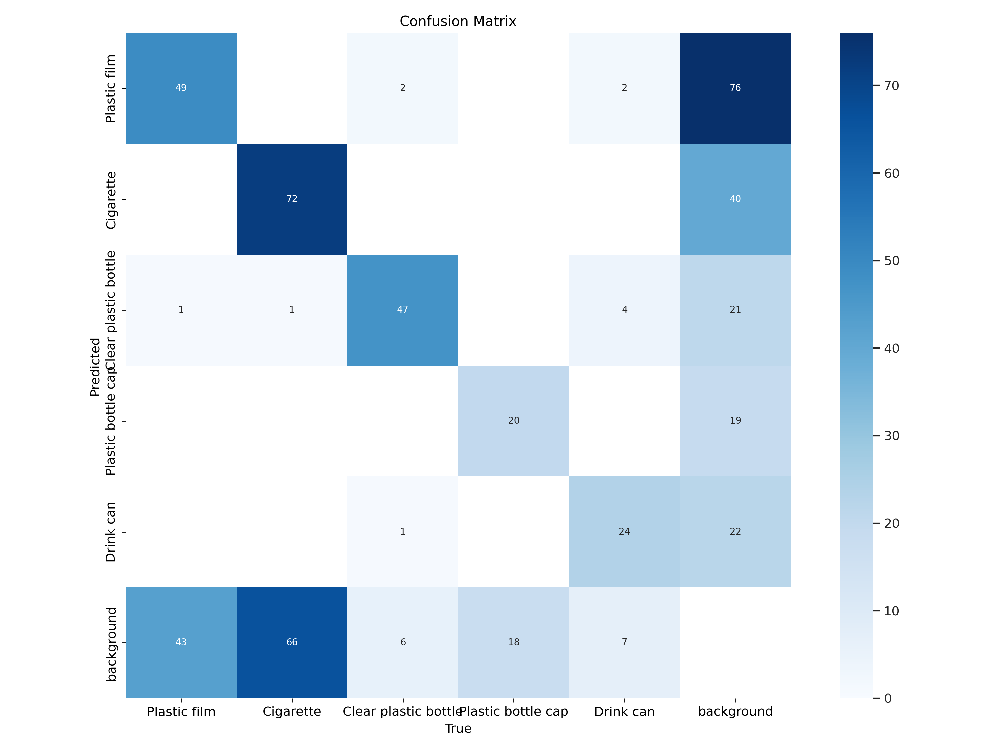

Below you can see the validation and training graphs for our final model. We can see that the validation loss across the three different loss functions shows consistent declines. Along with this, the performance metrics are consistently increasing, further indicating that the model is training appropriately. 

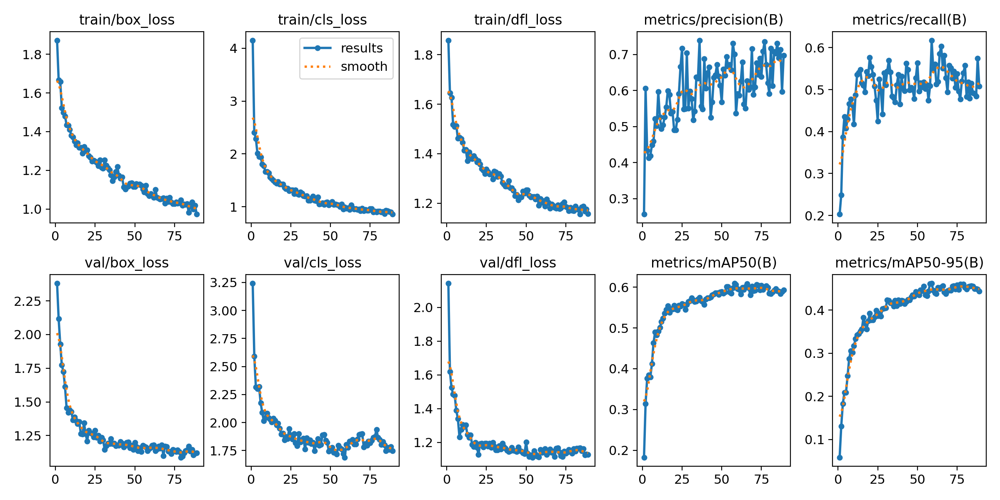

Overall, we beleive that the final model performed well. To acheive better model performance, it is necessary for the model to see more training data. Through the acquisition of new data, the model can be improved considerably. 

### 5.2 Model Evaluation for Custom CNN Object Detection Model from Scratch

Keep track of training loss and accuracy. analyze your training and validation.

---

## 6. Examples of Inference using Our Models

### 6.1 Inference Using our Fine-Tuned YOLO Model

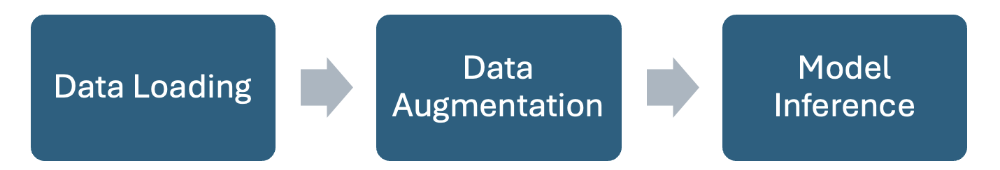

Below is the code that runs inference on some of our test images. As well as this, we include the ground truth bounding boxes to show what our model recognizes and what it cannot recognize. 

In [ ]:
def visualize_predictions(image_path, model, class_names):
    import cv2
    import matplotlib.pyplot as plt
    import numpy as np

    # Load the image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Run inference
    results = model(image_rgb)

    # Get predicted boxes, confidences, and class IDs
    predictions = results[0].boxes
    pred_boxes = predictions.xyxy.cpu().numpy()  # Bounding boxes in [x_min, y_min, x_max, y_max]
    pred_scores = predictions.conf.cpu().numpy()  # Confidence scores
    pred_class_ids = predictions.cls.cpu().numpy().astype(int)  # Class IDs

    # Load ground truth annotations (assumes YOLO format)
    # Replace this with the path to your labels directory and adjust as needed
    label_path = image_path.replace('images', 'labels').replace('.jpg', '.txt')
    gt_boxes = []
    gt_class_ids = []

    try:
        with open(label_path, 'r') as f:
            for line in f:
                class_id, x_center, y_center, width, height = map(float, line.strip().split())
                gt_class_ids.append(int(class_id))

                # Convert from YOLO format to x_min, y_min, x_max, y_max
                img_height, img_width = image.shape[:2]
                x_min = int((x_center - width / 2) * img_width)
                y_min = int((y_center - height / 2) * img_height)
                x_max = int((x_center + width / 2) * img_width)
                y_max = int((y_center + height / 2) * img_height)
                gt_boxes.append([x_min, y_min, x_max, y_max])
    except FileNotFoundError:
        print(f"No ground truth label found for {image_path}")
        gt_boxes = []
        gt_class_ids = []

    # Create copies of the image to draw on
    image_pred = image_rgb.copy()
    image_gt = image_rgb.copy()

    # Set font and box thickness
    font_scale = 2.0          # Increased font scale
    font_thickness = 4        # Increased font thickness
    box_thickness = 4         # Increased box thickness
    font = cv2.FONT_HERSHEY_SIMPLEX

    # Draw predicted bounding boxes in red on image_pred
    for box, class_id, score in zip(pred_boxes, pred_class_ids, pred_scores):
        x_min, y_min, x_max, y_max = map(int, box)
        label = f"{class_names[class_id]}: {score:.2f}"
        cv2.rectangle(image_pred, (x_min, y_min), (x_max, y_max), (255, 0, 0), thickness=box_thickness)

        # Adjust text position to stay within image boundaries
        text_y = y_min - 10 if y_min - 10 > 20 else y_min + 30
        cv2.putText(image_pred, label, (x_min, text_y), font, font_scale, (255, 0, 0), thickness=font_thickness)

    # Draw ground truth bounding boxes in green on image_gt
    for box, class_id in zip(gt_boxes, gt_class_ids):
        x_min, y_min, x_max, y_max = box
        label = f"{class_names[class_id]}"
        cv2.rectangle(image_gt, (x_min, y_min), (x_max, y_max), (0, 255, 0), thickness=box_thickness)

        # Adjust text position to stay within image boundaries
        text_y = y_min - 10 if y_min - 10 > 20 else y_min + 30
        cv2.putText(image_gt, label, (x_min, text_y), font, font_scale, (0, 255, 0), thickness=font_thickness)

    # Display the images side by side
    plt.figure(figsize=(24, 12))
    plt.subplot(1, 2, 1)
    plt.title('Predicted Bounding Boxes (Red)', fontsize=20)
    plt.imshow(image_pred)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Ground Truth Bounding Boxes (Green)', fontsize=20)
    plt.imshow(image_gt)
    plt.axis('off')

    plt.tight_layout()
    plt.show()

class_names = ['Plastic film', 'Cigarette', 'Clear plastic bottle', 'Plastic bottle cap', 'Drink can']


0: 1152x1536 1 Plastic film, 207.2ms
Speed: 11.2ms preprocess, 207.2ms inference, 1.8ms postprocess per image at shape (1, 3, 1152, 1536)


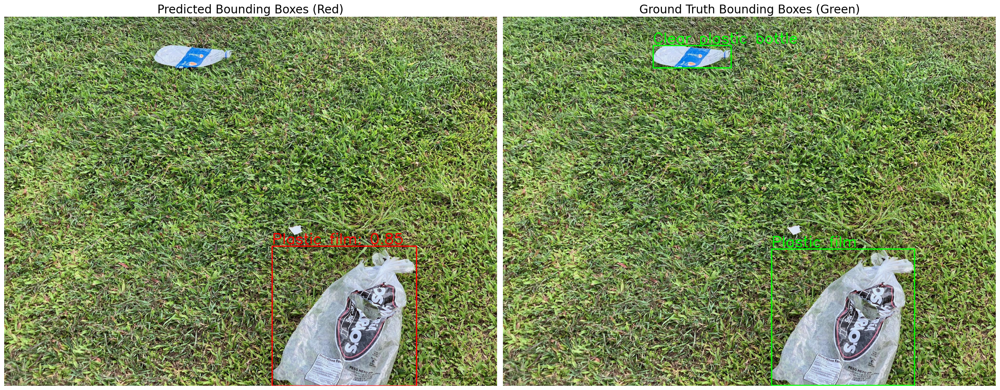


0: 1536x864 4 Cigarettes, 218.8ms
Speed: 10.3ms preprocess, 218.8ms inference, 2.1ms postprocess per image at shape (1, 3, 1536, 864)


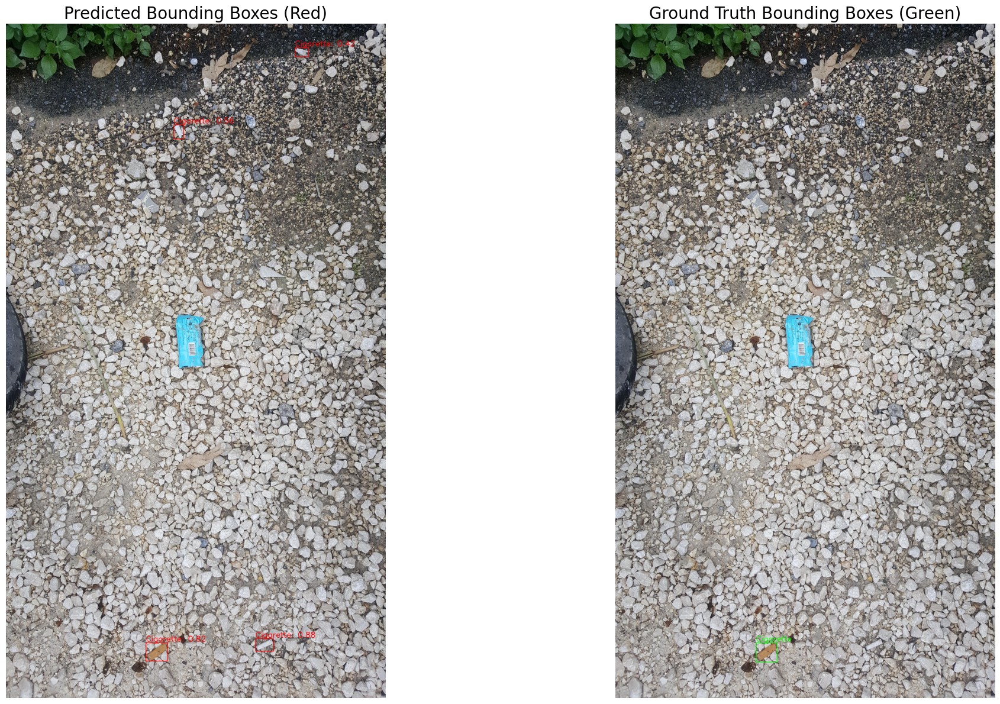


0: 1536x1152 1 Plastic film, 218.9ms
Speed: 13.4ms preprocess, 218.9ms inference, 2.0ms postprocess per image at shape (1, 3, 1536, 1152)


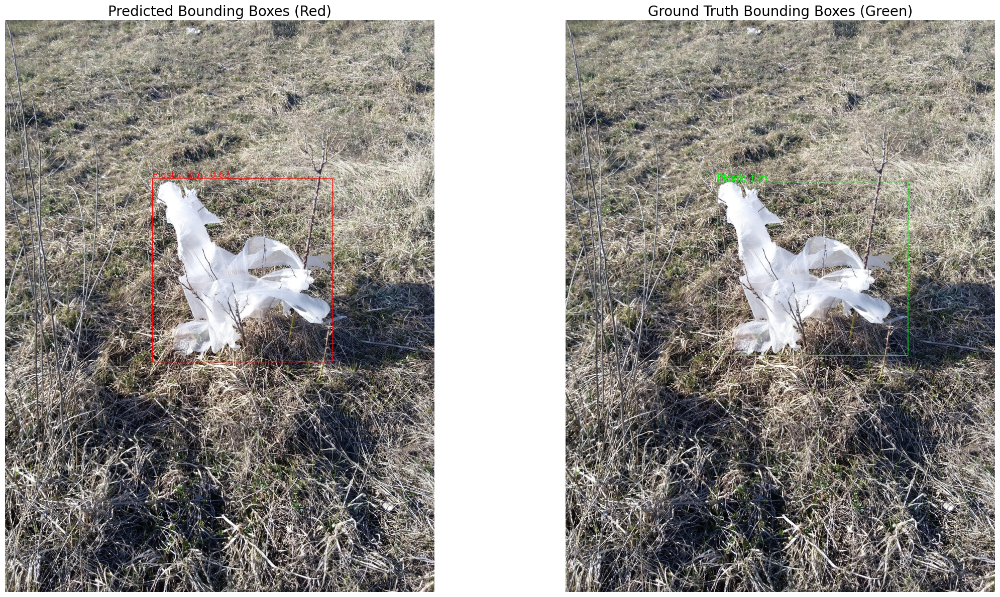


0: 1536x1152 1 Plastic bottle cap, 64.7ms
Speed: 11.5ms preprocess, 64.7ms inference, 1.7ms postprocess per image at shape (1, 3, 1536, 1152)


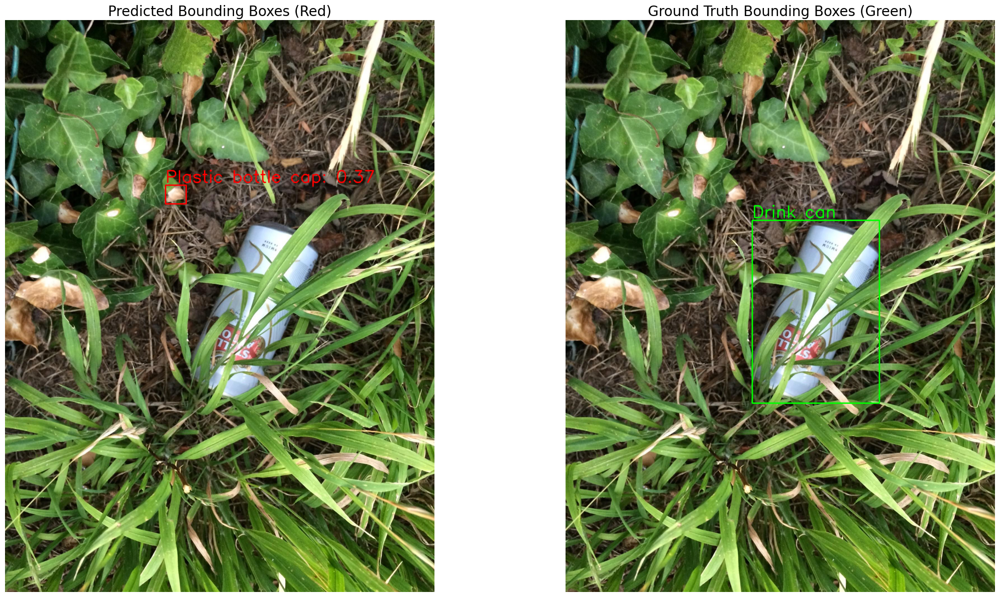

In [ ]:
# List of image paths to visualize
image_paths = [
    '/content/yolo_top_categories/test/images/664.jpg',
    '/content/yolo_top_categories/test/images/334.jpg',
    '/content/yolo_top_categories/test/images/275.jpg',
    '/content/yolo_top_categories/test/images/30.jpg'
]

for image_path in image_paths:
    visualize_predictions(image_path, model, class_names)

### 6.2 Inference Using our Fine-Tuned Custom CNN Object Detection Model

## 7. Results

This section contains content relavent for the model.evaluate section, where we run our model on the test set. 

The final YOLO model results are shown below. It shows that overall the model performed moderately well on the test set. Categories of plastic film and cigarette are the categories that the model is still struggling with the most.

| **Class**                  | **Images** | **Instances** | **Box(P)** | **R**   | **mAP50** | **mAP50-95** |
|----------------------------|------------|---------------|------------|---------|-----------|--------------|
| **All**                    | 162        | 363           | 0.677      | 0.529   | 0.633     | 0.488        |
| **Plastic Film**           | 64         | 93            | 0.490      | 0.441   | 0.451     | 0.331        |
| **Cigarette**              | 48         | 139           | 0.819      | 0.338   | 0.548     | 0.308        |
| **Clear Plastic Bottle**   | 45         | 56            | 0.736      | 0.768   | 0.843     | 0.701        |
| **Plastic Bottle Cap**     | 33         | 38            | 0.607      | 0.447   | 0.568     | 0.431        |
| **Drink Can**              | 28         | 37            | 0.731      | 0.649   | 0.753     | 0.671        |

## 8. Conclusion – Interpretation of Results

Overall – (we will outlien which model is better between YOLO and CNN and why)

## 9. Report Summary

## 10. Next Steps

The next steps for the YOLO model is to acquire more data. Having 200-500 instances of objects per category in the training dataset is not enough of a sample size to properly understand the objects. Further hyperparameter tuning can be done to test whether more exagerated data augmentation can imrpove the model.

## 11. Lessons Learned

| **Name**                 | **Lessons Learned**      |
|--------------------------|--------------------------|
| **Andre Graham**         | Completing this project significantly enhanced my understanding of object detection models and highlighted the critical role of data augmentation in improving model performance. Additionally, I gained valuable insights into the importance of efficiently managing GPU resources when training complex models. Leveraging A100 GPUs on Google Colab taught me the necessity of optimizing GPU usage to maximize their capabilities while minimizing training costs.                    |
| **Majed Qarmout**        |                          |
| **Younes Bensassi-Nour** |                          |
| **Yonatan Abebe**        |                          |
| **Adnan Shaikh**         |                          |

## 12. Presentation

Our presentation is included as a PDF in our submission.

## Appendix

### Section 1: requirements.txt

### Section 2: Link to GitHub

[GitHub Project Link](https://github.com/mqarmout/TACO_object__detection.git)